<a href="https://colab.research.google.com/github/tonu1990/AI_CV_Projects/blob/main/Project_Unsupervised_Fabric_Defect.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


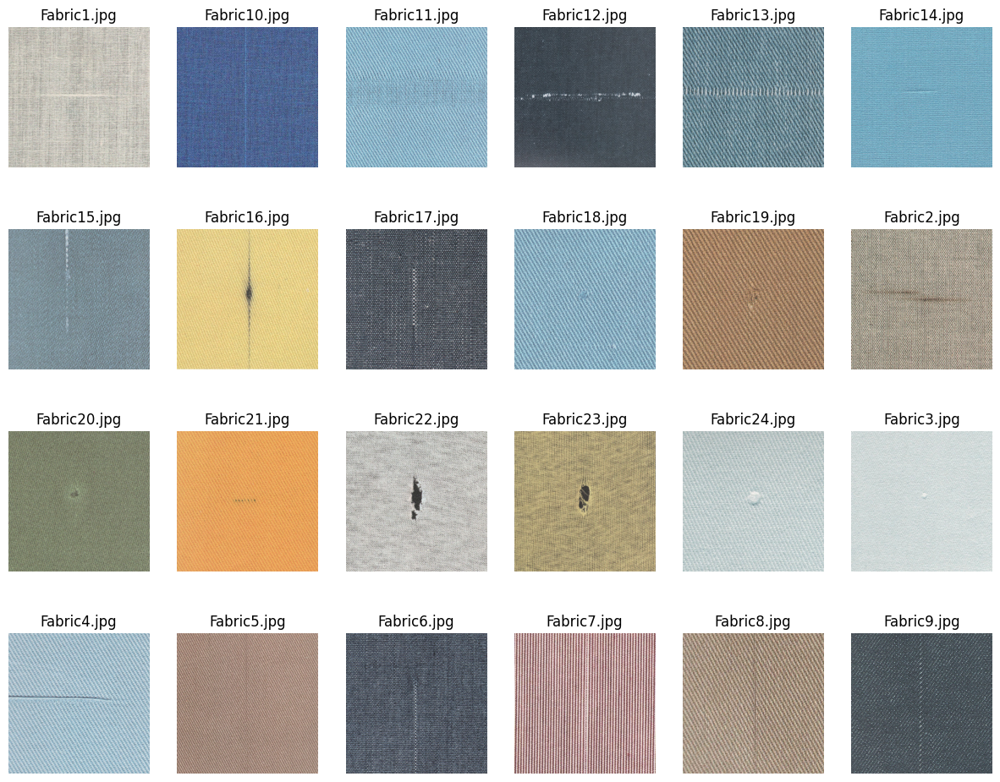

In [5]:
# Display all Fabric Images

import os
import glob
from PIL import Image
import matplotlib.pyplot as plt

# Path to the folder containing images
image_folder = '/content/drive/MyDrive/SelfLearning_AI/FabricDefect'

# Get all image files (JPG, PNG, BMP, GIF)
image_files = glob.glob(os.path.join(image_folder, '*.jpg'))
image_files = [f for f in sorted(image_files)]

# Display all images in a grid
plt.figure(figsize=(15, 15))

# Number of images per row
images_per_row = 6

# Display each image
for i, image_file in enumerate(image_files):
    img = Image.open(image_file)
    plt.subplot(len(image_files) // images_per_row + 1, images_per_row, i + 1)
    plt.imshow(img)
    plt.title(os.path.basename(image_file))
    plt.axis('off')

plt.show()


* Load and Preprocess the Image

* Divide the image into overlapping patches of size patch_size x patch_size. The stride controls the overlap between patches (e.g., stride=16 means 50% overlap for patch_size=32).
  *     Patches allow localized analysis of the image, which is crucial for defect localization.
  * Overlapping patches ensure defects are not missed at patch boundaries.

In [11]:
def extract_lbp_features(patches, radius=3, n_points=24):
    lbp_features = []
    for patch in patches:
        lbp = local_binary_pattern(patch, n_points, radius, method="uniform")
        hist, _ = np.histogram(lbp.ravel(), bins=np.arange(0, n_points + 3), range=(0, n_points + 2))
        hist = hist.astype("float")
        hist /= (hist.sum() + 1e-6)  # Normalize histogram
        lbp_features.append(hist)
    return np.array(lbp_features)

/usr/local/lib/python3.11/dist-packages/skimage/feature/texture.py:385: UserWarning: Applying `local_binary_pattern` to floating-point images may give unexpected results when small numerical differences between adjacent pixels are present. It is recommended to use this function with images of integer dtype.
  warnings.warn(
<ipython-input-12-3685117e40c4>:51: FutureWarning: `square` is deprecated since version 0.25 and will be removed in version 0.27. Use `skimage.morphology.footprint_rectangle` instead.
  defect_mask = binary_opening(defect_mask, square(3))  # Remove small noise


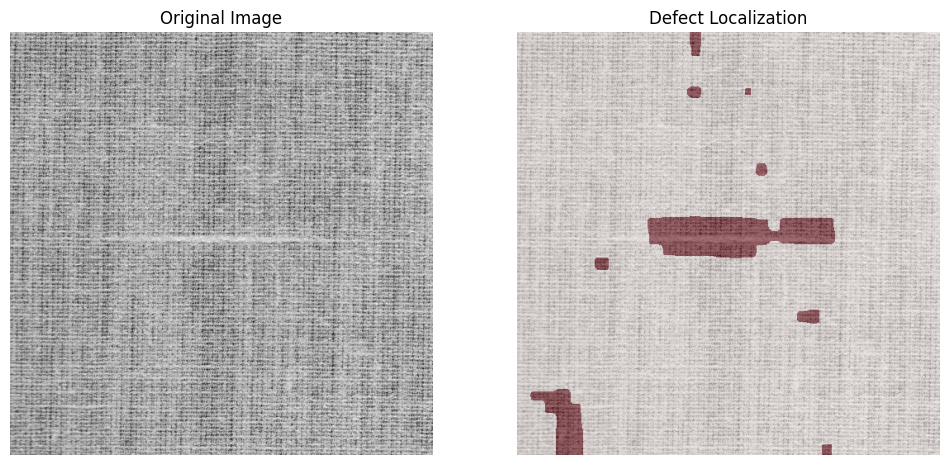

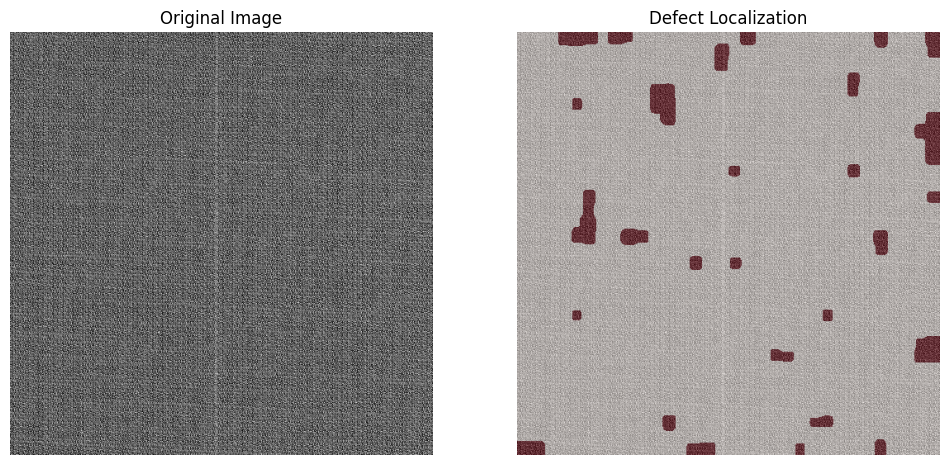

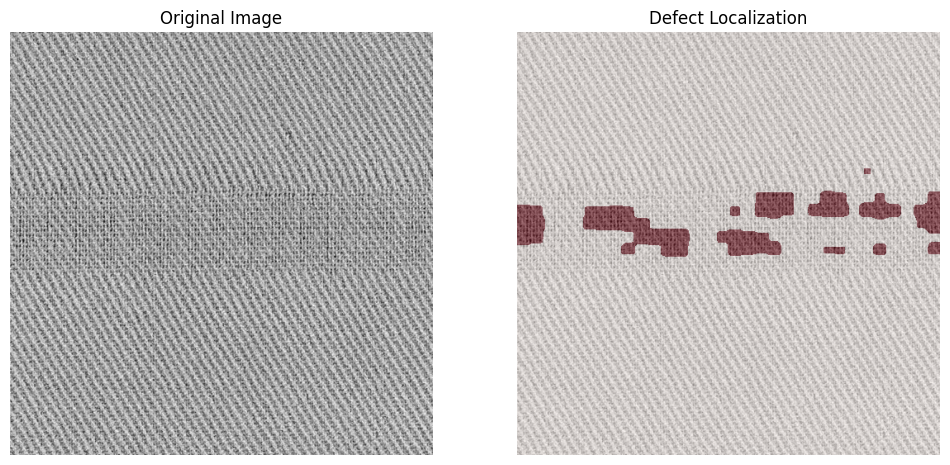

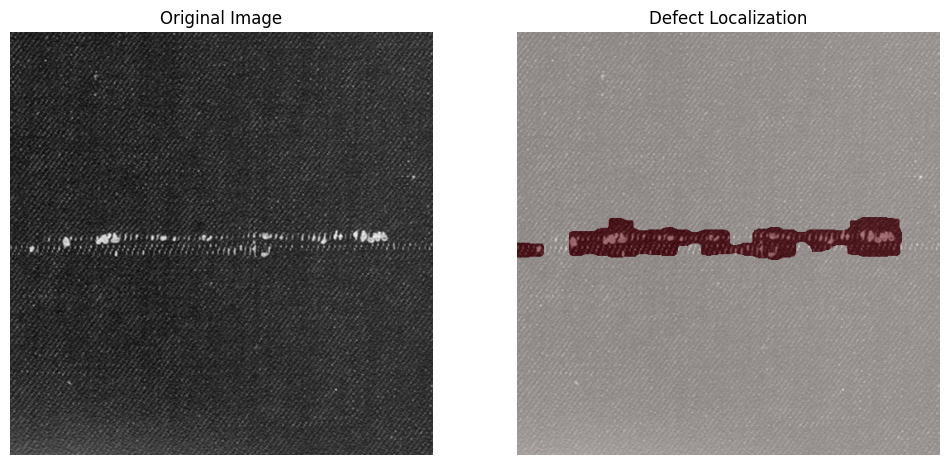

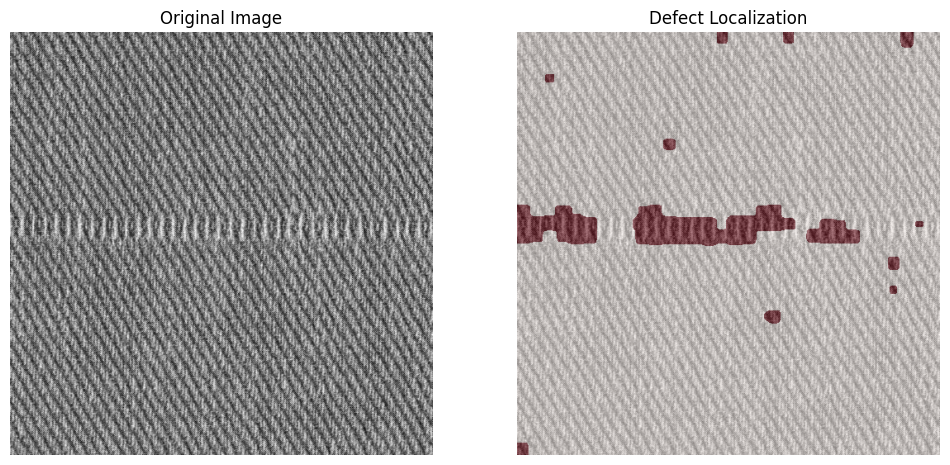

...

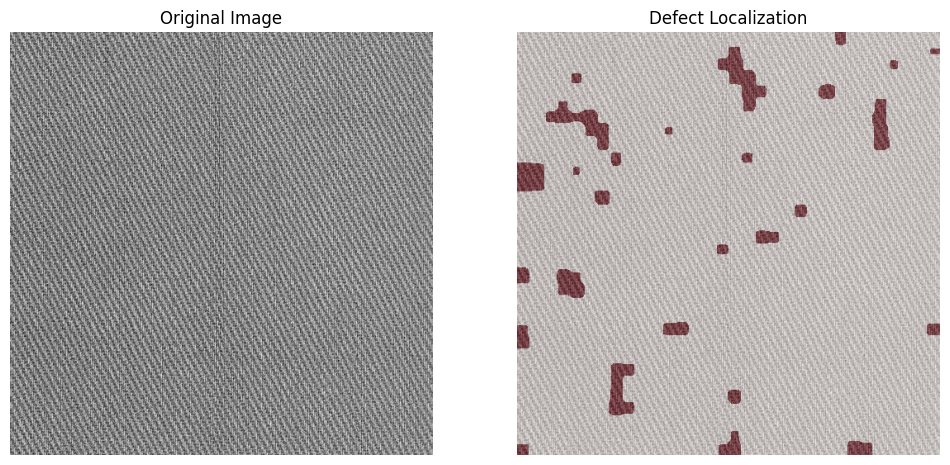

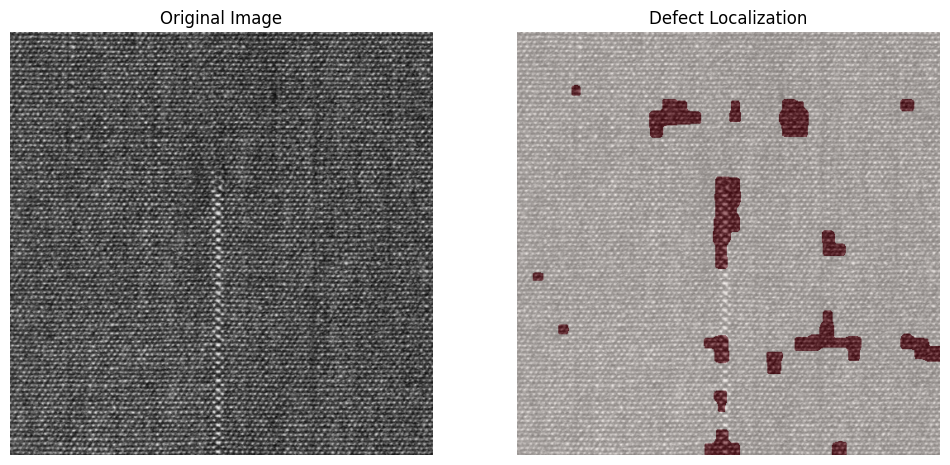

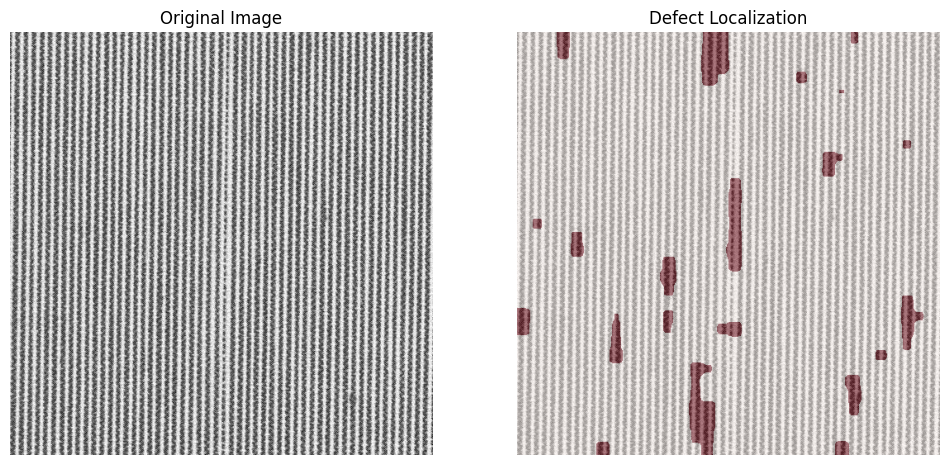

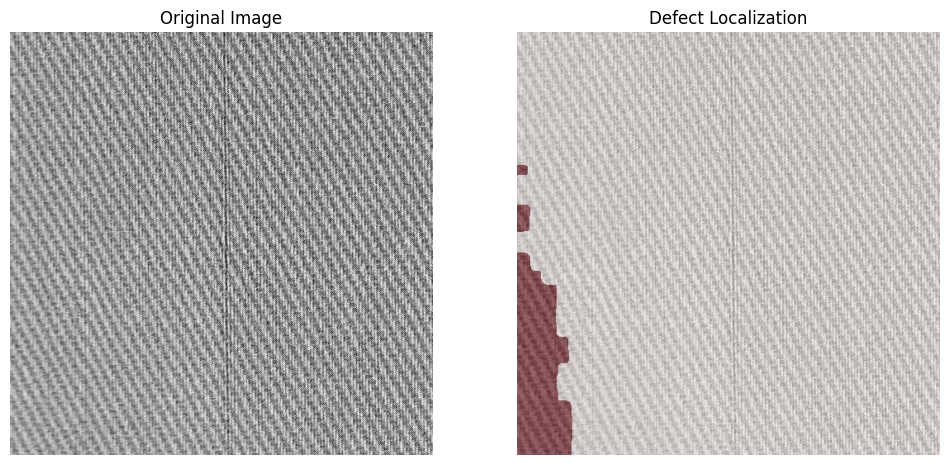

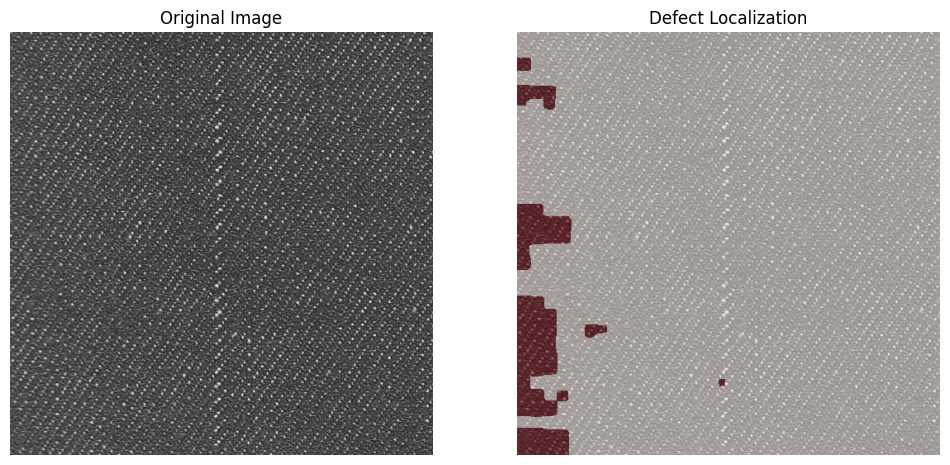

In [12]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import local_binary_pattern
from skimage.filters import gaussian
from skimage.morphology import binary_opening, square

# Process all Fabric Images

for i, image_file in enumerate(image_files):
  image = cv2.imread(image_file, cv2.IMREAD_GRAYSCALE)
  image = cv2.resize(image, (512, 512))
  image = image / 255.0

  # extract patches
  patch_size = 32
  stride = 16
  patches = []
  for y in range(0, image.shape[0] - patch_size + 1, stride):
    for x in range(0, image.shape[1] - patch_size + 1, stride):
        patch = image[y:y+patch_size, x:x+patch_size]
        patches.append(patch)
  patches = np.array(patches)

  # Extract Features (Local Binary Patterns)
  lbp_features = extract_lbp_features(patches)

  mean_features = np.mean(lbp_features, axis=0)
  std_features = np.std(lbp_features, axis=0)
  anomaly_scores = []
  for feature in lbp_features:
    z_scores = np.abs((feature - mean_features) / (std_features + 1e-6))
    anomaly_scores.append(np.mean(z_scores))
  anomaly_scores = np.array(anomaly_scores)

  heatmap = np.zeros_like(image, dtype="float")
  count_map = np.zeros_like(image, dtype="float")
  index = 0
  for y in range(0, image.shape[0] - patch_size + 1, stride):
    for x in range(0, image.shape[1] - patch_size + 1, stride):
        heatmap[y:y+patch_size, x:x+patch_size] += anomaly_scores[index]
        count_map[y:y+patch_size, x:x+patch_size] += 1
        index += 1

  heatmap /= (count_map + 1e-6)  # Normalize heatmap
  heatmap = gaussian(heatmap, sigma=2)  # Smooth the heatmap

  threshold = np.percentile(heatmap, 95)  # Use 95th percentile as threshold
  defect_mask = heatmap > threshold

  defect_mask = binary_opening(defect_mask, square(3))  # Remove small noise

  plt.figure(figsize=(12, 6))
  plt.subplot(1, 2, 1)
  plt.imshow(image, cmap="gray")
  plt.title("Original Image")
  plt.axis('off')

  plt.subplot(1, 2, 2)
  plt.imshow(image, cmap="gray")
  plt.imshow(defect_mask, cmap="Reds", alpha=0.5)  # Overlay defect mask
  plt.title("Defect Localization")
  plt.axis('off')

  plt.show()




**Extract Features (Local Binary Patterns)**
*     Compute Local Binary Patterns (LBP) for each patch.
*    LBP captures texture information by comparing each pixel to its neighbors.
*    Generate a histogram of LBP values for each patch and normalize it.
* Normalized histograms ensure consistent feature representation.

**Detect Anomalies**

*     Compute the mean and standard deviation of the LBP features across all patches.
* Calculate the Z-score for each patch’s features to measure how much it deviates from the mean.
*    Average the Z-scores to get an anomaly score for each patch.
*    Z-scores quantify how unusual a patch is compared to the rest of the image.
*    Patches with high anomaly scores are likely to contain defects.

**Create a Heatmap**

* Initialize a heatmap and a count map with the same size as the image.

*   Accumulate anomaly scores in the heatmap and count the number of patches contributing to each pixel.

*    Normalize the heatmap by dividing by the count map.

*    Smooth the heatmap using a Gaussian filter to reduce noise.

*   The heatmap visualizes the likelihood of defects at each pixel.

*    Smoothing ensures the heatmap is visually interpretable.